In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import datetime
from datetime import timedelta

from urllib.request import urlopen
import json

from plotly.express import choropleth as px_choropleth
from plotly.express import colors as px_colors

In [2]:
def mdy(date):
    month = date.month
    if(month<10): month = '0'+str(month)
    
    day = date.day
    if(day<10): day = '0'+str(day)
        
    year = date.year
    
    return str(month)+'-'+str(day)+'-'+str(year)

def daysBack(date, days):
    return date-timedelta(days=days)

def daysForward(date, days):
    return date+timedelta(days=days)

def days_between(d1, d2):
    return abs((d2 - d1).days)

In [3]:
now = datetime.datetime.now().replace(microsecond=0, second=0, minute=0, hour=0)
begin = datetime.datetime(2020, 3, 22)
day = timedelta(days=1)
btw = days_between(begin, datetime.datetime.now())

In [4]:
url = 'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_daily_reports/'
csv = '.csv'

In [5]:
i = 1
df = pd.read_csv(url+mdy(begin)+csv, 
                 parse_dates=['Last_Update'],
                 dtype={'FIPS': str})
adjFip = []
for fip in df['FIPS']:
    if isinstance(fip, float) == False:
        if len(fip)==4: 
            fip = '0'+fip
    adjFip.append(fip)
df['FIPS']=adjFip

while i < btw:
    print(i)
    site = url+mdy(begin+timedelta(days=i))+csv
    df_temp = pd.read_csv(site, 
                          parse_dates=['Last_Update'],
                          dtype={'FIPS':str})
    adjFip = []
    for fip in df_temp['FIPS']:
        if isinstance(fip, float) == False:
            if len(fip)==4: 
                fip = '0'+fip
        adjFip.append(fip)
    df_temp['FIPS']=adjFip
    
    df_temp['Last_Update'] = df_temp['Last_Update'].dt.floor('d')

    df = df.append(df_temp)
    i = i + 1

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120


In [6]:
df['Last_Update'] = df['Last_Update'].dt.floor('d')

In [7]:
df = df[df['Country_Region']=='US']
df = df[['FIPS', 'Admin2', 'Province_State', 'Last_Update', 'Confirmed', 'Deaths']]
df = df.reset_index(drop=True)

In [8]:
df.tail(10)

,FIPS,Admin2,Province_State,Last_Update,Confirmed,Deaths
359811,27163,Washington,Minnesota,2020-07-21,1465,40
359812,27165,Watonwan,Minnesota,2020-07-21,279,0
359813,27167,Wilkin,Minnesota,2020-07-21,23,3
359814,27169,Winona,Minnesota,2020-07-21,186,16
359815,27171,Wright,Minnesota,2020-07-21,623,4
359816,27173,Yellow Medicine,Minnesota,2020-07-21,35,0
359817,40129,Roger Mills,Oklahoma,2020-07-20,3,0
359818,02070,Dillingham,Alaska,2020-07-17,1,0
359819,16061,Lewis,Idaho,2020-07-10,1,0
359820,41069,Wheeler,Oregon,2020-07-06,0,0


In [9]:
def rev_sum(arr):
    arr = arr.reset_index(drop=True)
    ret = np.arange(len(arr))
    for i in range(0, len(arr)-1, 1):
        ret[i+1]=abs(arr[i]-arr[i+1])
        ret[0]=arr[0]
    return ret

In [10]:
#add running weekly average
list1 = df['FIPS'].unique().tolist()
list1.remove(np.nan)
frames = []

for county in list1:
    df_temp = df[df['FIPS']==county]
    df_temp = df_temp.sort_values(by='Last_Update')
    
    #first add the daily number for each county
    df_temp['newCases'] = rev_sum(df_temp['Confirmed'])
    df_temp['newDeaths'] = rev_sum(df_temp['Deaths'])
    
#     df_temp = df_temp.iloc[::-1]
    df_temp['weekly case avg'] = df_temp['newCases'].rolling(window=7).mean()
    df_temp['weekly death avg'] = df_temp['newDeaths'].rolling(window=7).mean()

    df_temp['case proportion'] = df_temp['weekly case avg']/df_temp['weekly case avg'].max()
    df_temp['death proportion'] = df_temp['weekly death avg']/df_temp['weekly death avg'].max()

    try:
        df_temp['peak case day'] = df_temp[df_temp['case proportion'] == 1]['Last_Update'].iloc[-1]
    except:
        print('no peak cases...')

    df_temp = df_temp.drop_duplicates(subset=['Last_Update'])
    frames.append(df_temp)
    print('Done: '+str(county))
    
df2 = pd.concat(frames)
df2.head(10)

Done: 36061
Done: 36059
Done: 36119
Done: 36103
Done: 36087
Done: 36071
Done: 36001
Done: 36027
Done: 36055
Done: 36029
Done: 36067
Done: 36091
Done: 36093
Done: 36079
Done: 36083
Done: 36111
Done: 36021
Done: 36109
Done: 36105
Done: 36063
Done: 36065
Done: 36069
Done: 36019
Done: 36043
Done: 36007
Done: 36057
Done: 36031
Done: 36117
Done: 36039
Done: 36003
Done: 36121
Done: 36041
Done: 36017
Done: 36101
Done: 36051
Done: 36023
Done: 36025
Done: 36107
Done: 36037
Done: 36113
Done: 36115
Done: 36095
Done: 36035
Done: 36045
Done: 53033
Done: 53061
Done: 53053
Done: 53057
Done: 53029
Done: 53063
Done: 53025
Done: 53035
Done: 53077
Done: 53073
Done: 53067
Done: 53011
Done: 53005
Done: 53031
Done: 53037
Done: 53039
Done: 53009
Done: 53015
Done: 53007
Done: 53021
Done: 53041
Done: 53027
Done: 53013
Done: 53043
Done: 53045
Done: 53071
Done: 53065
Done: 53055
Done: 53075
Done: 34003
Done: 34013
Done: 34025
Done: 34023
Done: 34017
Done: 34039
Done: 34027
Done: 34029
Done: 34031
Done: 34035
Done

Done: 51117
Done: 51163
Done: 51093
Done: 51067
Done: 51590
Done: 51019
Done: 51009
Done: 51065
Done: 51109
Done: 28049
Done: 28033
Done: 28047
Done: 28035
Done: 28109
Done: 28089
Done: 28083
Done: 28027
Done: 28139
Done: 28121
Done: 28051
Done: 28081
Done: 28059
Done: 28071
Done: 28029
Done: 28045
Done: 28085
Done: 28087
Done: 28011
Done: 28157
Done: 28037
Done: 28093
Done: 28113
Done: 28057
Done: 28151
Done: 28095
Done: 28147
Done: 28159
Done: 28077
Done: 28043
Done: 28107
Done: 28143
Done: 28105
Done: 28133
Done: 28111
Done: 28067
Done: 28129
Done: 28163
Done: 28053
Done: 28155
Done: 28001
Done: 28025
Done: 28039
Done: 28007
Done: 28079
Done: 28127
Done: 28145
Done: 28017
Done: 28097
Done: 28115
Done: 28123
Done: 28137
Done: 18097
Done: 18057
Done: 18081
Done: 18089
Done: 18063
Done: 18141
Done: 18067
Done: 18005
Done: 18047
Done: 18019
Done: 18003
Done: 18039
Done: 18011
Done: 18043
Done: 18091
Done: 18157
Done: 18095
Done: 18167
Done: 18053
Done: 18035
Done: 18059
Done: 18113
Done

Done: 13101
Done: 13105
Done: 13107
Done: 13109
Done: 13111
Done: 13119
Done: 13123
Done: 13125
Done: 13131
Done: 13133
Done: 13137
Done: 13141
Done: 13143
Done: 13145
Done: 13147
Done: 13155
Done: 13157
Done: 13159
Done: 13161
Done: 13163
Done: 13165
Done: 13167
Done: 13169
Done: 13173
Done: 13179
Done: 13183
Done: 13193
Done: 13195
Done: 13197
Done: 13189
Done: 13191
Done: 13199
Done: 13205
Done: 13209
Done: 13211
Done: 13213
Done: 13221
Done: 13229
Done: 13231
Done: 13235
Done: 13237
Done: 13239
Done: 13241
Done: 13249
Done: 13251
Done: 13253
Done: 13257
Done: 13259
Done: 13263
Done: 13265
Done: 13267
Done: 13269
Done: 13271
Done: 13275
Done: 13279
Done: 13281
Done: 13283
Done: 13291
Done: 13293
Done: 13295
Done: 13297
Done: 13299
Done: 13301
Done: 13303
Done: 13305
Done: 13307
Done: 13309
Done: 13311
Done: 13315
Done: 13317
Done: 13319
Done: 15001
no peak cases...
Done: 15005
Done: 16003
Done: 16005
Done: 16007
Done: 16009
Done: 16015
Done: 16017
Done: 16019
Done: 16021
no peak cas

Done: 28149
Done: 28153
Done: 28161
Done: 29003
Done: 29005
Done: 29007
Done: 29009
Done: 29011
Done: 29015
Done: 29017
Done: 29021
Done: 29023
Done: 29025
Done: 29027
Done: 29029
Done: 29031
Done: 29033
Done: 29035
Done: 29039
Done: 29041
Done: 29045
Done: 29047
Done: 29049
Done: 29053
Done: 29055
Done: 29057
Done: 29059
Done: 29061
Done: 29063
Done: 29065
Done: 29067
Done: 29071
Done: 29073
Done: 29075
Done: 29079
Done: 29081
Done: 29085
Done: 29087
Done: 29089
Done: 29091
Done: 29093
Done: 29099
Done: 29103
Done: 29105
Done: 29107
Done: 29109
Done: 29111
Done: 29113
Done: 29115
Done: 29117
Done: 29121
Done: 29123
Done: 29125
Done: 29127
Done: 29119
Done: 29129
Done: 29131
Done: 29133
Done: 29135
Done: 29137
Done: 29139
Done: 29141
Done: 29143
Done: 29145
Done: 29147
Done: 29149
Done: 29151
Done: 29153
Done: 29155
Done: 29157
Done: 29159
Done: 29161
Done: 29163
Done: 29165
Done: 29167
Done: 29171
Done: 29173
Done: 29175
Done: 29177
Done: 29179
Done: 29181
Done: 29195
Done: 29197
Done

Done: 47111
Done: 47113
Done: 47117
Done: 47109
Done: 47121
Done: 47127
Done: 47129
Done: 47131
Done: 47133
Done: 47137
Done: 47139
Done: 47143
Done: 47153
Done: 47159
Done: 47161
Done: 47169
Done: 47171
Done: 47173
Done: 47175
Done: 47177
Done: 47181
Done: 47183
Done: 47185
Done: 48001
Done: 48003
Done: 48005
Done: 48007
Done: 48009
Done: 48011
Done: 48015
Done: 48017
Done: 48019
Done: 48021
Done: 48023
Done: 48025
Done: 48031
no peak cases...
Done: 48033
Done: 48035
Done: 48043
Done: 48045
Done: 48047
Done: 48051
Done: 48055
Done: 48057
Done: 48059
Done: 48063
Done: 48065
Done: 48067
Done: 48073
Done: 48075
Done: 48077
Done: 48079
Done: 48081
Done: 48083
Done: 48087
Done: 48089
Done: 48093
Done: 48095
Done: 48097
Done: 48099
Done: 48101
Done: 48105
Done: 48107
Done: 48109
Done: 48111
Done: 48115
Done: 48119
Done: 48125
Done: 48127
Done: 48129
Done: 48131
Done: 48133
Done: 48135
Done: 48137
Done: 48143
Done: 48145
Done: 48151
Done: 48153
Done: 48155
Done: 48159
Done: 48161
Done: 48163

no peak cases...
Done: 72111
no peak cases...
Done: 72113
no peak cases...
Done: 72115
no peak cases...
Done: 72117
no peak cases...
Done: 72119
no peak cases...
Done: 72121
no peak cases...
Done: 72123
no peak cases...
Done: 72125
no peak cases...
Done: 72127
no peak cases...
Done: 72129
no peak cases...
Done: 72131
no peak cases...
Done: 72133
no peak cases...
Done: 72135
no peak cases...
Done: 72137
no peak cases...
Done: 72139
no peak cases...
Done: 72999
no peak cases...
Done: 72141
no peak cases...
Done: 72143
no peak cases...
Done: 72145
no peak cases...
Done: 72147
no peak cases...
Done: 72149
no peak cases...
Done: 72151
no peak cases...
Done: 72153
no peak cases...
Done: 80022


,FIPS,Admin2,Province_State,Last_Update,Confirmed,Deaths,newCases,newDeaths,weekly case avg,weekly death avg,case proportion,death proportion,peak case day
0,36061,New York City,New York,2020-03-22,9654,63,9654,63,NaN,NaN,NaN,NaN,2020-04-18
5245,36061,New York City,New York,2020-03-23,12305,99,2651,36,NaN,NaN,NaN,NaN,2020-04-18
8422,36061,New York City,New York,2020-03-24,14904,131,2599,32,NaN,NaN,NaN,NaN,2020-04-18
11599,36061,New York City,New York,2020-03-25,17856,199,2952,68,NaN,NaN,NaN,NaN,2020-04-18
14775,36061,New York City,New York,2020-03-26,21873,281,4017,82,NaN,NaN,NaN,NaN,2020-04-18
17949,36061,New York City,New York,2020-03-27,25573,366,3700,85,NaN,NaN,NaN,NaN,2020-04-18
21130,36061,New York City,New York,2020-03-28,29776,517,4203,151,4253.714286,73.857143,0.799055,0.068450,2020-04-18
24308,36061,New York City,New York,2020-03-29,33768,678,3992,161,3444.857143,87.857143,0.647112,0.081425,2020-04-18
27490,36061,New York City,New York,2020-03-30,37453,790,3685,112,3592.571429,98.714286,0.674860,0.091487,2020-04-18
30007,36061,New York City,New York,2020-03-31,43119,932,5666,142,4030.714286,114.428571,0.757165,0.106051,2020-04-18


In [11]:
df2.columns

Index(['FIPS', 'Admin2', 'Province_State', 'Last_Update', 'Confirmed',
       'Deaths', 'newCases', 'newDeaths', 'weekly case avg',
       'weekly death avg', 'case proportion', 'death proportion',
       'peak case day'],
      dtype='object')

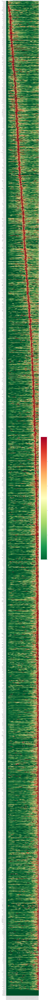

In [12]:
# dates = df2['peak case day']
# df2['pcd date'] = dates.apply(lambda x: try: x.strftime('%m-%d-%Y'))

df1 = df2.copy()
df1['County'] = df1['FIPS']+' ('+df1['Province_State']+')'

df1['weekly case avg'] = df1['weekly case avg'].fillna(0)
df1['weekly death avg'] = df1['weekly death avg'].fillna(0)
df1['case proportion'] = df1['case proportion'].fillna(0)
df1['death proportion'] = df1['death proportion'].fillna(0)

#how to sort all counties by peak case day
recent = df1[df1['Last_Update']==datetime.datetime(2020, 7, 13)]
val = recent.sort_values(by=['County'])[['County', 'peak case day']]
val = val.set_index('County')
val

county_heat = df1.pivot(index='County', columns='Last_Update', values='case proportion')
county_heat = county_heat.join(val, how='inner')
county_heat = county_heat.sort_values(by='peak case day')
county_heat = county_heat.drop(['peak case day'], axis=1)
county_heat = county_heat.fillna(0)

fig, ax = plt.subplots(figsize=(20,500))
sns.heatmap(county_heat, cmap='RdYlGn_r', vmin=0, vmax=1, linewidths=.005, linecolor='black')
plt.title('Proportion of Average Daily Cases over 1 Week, Organized by Date of Most Recent Peak')

fig.savefig('county/Normalized Weekly Average of Daily Cases')

In [13]:
county_heat

,2020-03-22,2020-03-23,2020-03-24,2020-03-25,2020-03-26,2020-03-27,2020-03-28,2020-03-29,2020-03-30,2020-03-31,...,2020-07-12,2020-07-13,2020-07-14,2020-07-15,2020-07-16,2020-07-17,2020-07-18,2020-07-19,2020-07-20,2020-07-21
County,,,,,,,,,,,,,,,,,,,,,
99999 (Grand Princess),0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.719626,0.700935,0.700935,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
53033 (Washington),0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.538758,0.477130,0.558498,...,0.378430,0.425614,0.467983,0.496389,0.501204,0.548387,0.576793,0.666827,0.639384,0.597978
05023 (Arkansas),0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.940000,0.580000,0.580000,...,0.400000,0.420000,0.360000,0.400000,0.380000,0.480000,0.420000,0.460000,0.440000,0.460000
50027 (Vermont),0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.555556,0.333333,0.166667,...,0.166667,0.166667,0.166667,0.166667,0.166667,0.166667,0.166667,0.166667,0.166667,0.277778
50017 (Vermont),0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.000000,0.333333,...,0.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.333333,0.333333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90036 (New York),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
90038 (North Dakota),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
90042 (Pennsylvania),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [14]:
df_map = df2[df2['Last_Update']==now]
peakDates = df_map['peak case day']
df_map['daysSince'] = peakDates.apply(lambda x: days_between(x, datetime.datetime.now()))
df_map.head()

/Users/carterpace/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,FIPS,Admin2,Province_State,Last_Update,Confirmed,Deaths,newCases,newDeaths,weekly case avg,weekly death avg,case proportion,death proportion,peak case day,daysSince
358617,36061,New York City,New York,2020-07-21,221703,23411,284,11,343.142857,12.571429,0.064459,0.011651,2020-04-18,94.0
358596,36059,Nassau,New York,2020-07-21,42678,2193,56,0,46.285714,0.428571,0.033916,0.004011,2020-04-09,103.0
359608,36119,Westchester,New York,2020-07-21,35551,1440,36,0,32.000000,0.714286,0.028444,0.011261,2020-03-28,115.0
359254,36103,Suffolk,New York,2020-07-21,42496,1994,30,0,54.857143,0.142857,0.037773,0.002653,2020-04-10,102.0
358997,36087,Rockland,New York,2020-07-21,13798,672,5,0,11.285714,0.285714,0.024749,0.012658,2020-04-06,106.0


In [15]:
display = df_map.sort_values(by='weekly case avg', ascending=False)
display.head(10)

,FIPS,Admin2,Province_State,Last_Update,Confirmed,Deaths,newCases,newDeaths,weekly case avg,weekly death avg,case proportion,death proportion,peak case day,daysSince
358274,06037,Los Angeles,California,2020-07-21,159045,4104,3128,8,3241.142857,40.000000,0.987079,0.793201,2020-07-18,3.0
358468,12086,Miami-Dade,Florida,2020-07-21,87035,1309,2797,7,2760.285714,23.714286,0.958528,1.000000,2020-07-19,2.0
358345,04013,Maricopa,Arizona,2020-07-21,96711,1485,1240,12,2213.571429,49.285714,0.785074,0.982906,2020-07-07,14.0
356788,48029,Bexar,Texas,2020-07-21,31316,262,481,5,1586.142857,9.571429,0.992491,0.788235,2020-07-20,1.0
357783,48201,Harris,Texas,2020-07-21,57071,545,1328,9,1386.000000,11.285714,0.841019,0.897727,2020-07-18,3.0
356866,12011,Broward,Florida,2020-07-21,40976,512,1695,19,1356.000000,6.857143,0.907110,0.857143,2020-07-17,4.0
357110,32003,Clark,Nevada,2020-07-21,31312,527,880,0,1072.714286,6.285714,1.000000,0.733333,2020-07-21,0.0
357292,48113,Dallas,Texas,2020-07-21,42292,526,2070,3,1054.000000,9.857143,0.835561,0.884615,2020-07-18,3.0
358803,42101,Philadelphia,Pennsylvania,2020-07-21,23925,1658,4271,7,698.857143,4.571429,1.000000,0.116364,2020-07-21,0.0
357837,48215,Hidalgo,Texas,2020-07-21,12787,318,524,34,678.142857,24.000000,1.000000,1.000000,2020-07-21,0.0


In [16]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

In [17]:
fig = px_choropleth(df_map,
                    geojson=counties,
                    locations='FIPS',
                    scope="usa",
                    color="daysSince",
                    color_continuous_scale=px_colors.sequential.YlOrRd_r,
                    title="Days Since Last Peak of New COVID-19 Cases (7-Day Average)"
                   )
fig.update_layout(margin={"r":0,"t":50,"l":20,"b":0})
fig.show()

# fig.write_image("county/Days Since Last Peak.png", scale=5)

In [18]:
fig = px_choropleth(df_map,
                    geojson=counties,
                    locations='FIPS',
                    scope="usa",
                    color="case proportion",
                    color_continuous_scale=px_colors.sequential.YlOrRd,
                    title="Percentage of Current Infection from Highest Infection per County"
                   )
fig.update_layout(margin={"r":0,"t":50,"l":20,"b":0})
fig.show()

# fig.write_image("county/Current Peak Status.png", scale=5)

## Travis County

In [19]:
#date labels
def county_plot(fipNum):
    c = df1[df1['FIPS']==str(fipNum)]
    dates = []
    for d in c['Last_Update'].tolist():
        if d.day==1: dates.append(str(d.date()))
        else: dates.append('')

    x_val = np.arange(len(c['Last_Update']))

    #plotting
    fig, ax1 = plt.subplots(figsize=(20,8))

    ax1.set_xlabel('Date')
    ax1.set_ylabel('Daily Cases and Deaths')
    ax1.bar(x=x_val, bottom=0, height=c['newCases'], label='Daily Cases', color='c')
    ax1.bar(x=x_val, bottom=0, height=c['newDeaths'], label='Daily Deaths', color='r')
    ax1.plot(x_val, c['weekly case avg'],  label='Moving 7-Day Case Average', color='b', linestyle='dashed')

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
    ax2.set_ylabel('% of Tests Returned Positive')
    ax2.plot(x_val, c['Confirmed'],  label='Total Cases', color='k')

    plt.title('Daily Increase in Cases and Deaths for '
              +str(c['Admin2'].values.tolist()[0])
              +' County, '
              +str(c['Province_State'].values.tolist()[0]))
    ax1.legend(loc='upper left')
    ax2.legend(loc='upper right')
    plt.xticks(x_val, dates, rotation=30) 
    fig = plt.gcf()
    ax1.grid(axis='y')
    plt.show()
#     fig.savefig('county/'
#                 +str(c['Admin2'].values.tolist()[0])
#                 +' County, '
#                 +str(c['Province_State'].values.tolist()[0]))

In [20]:
# 48453 = Travis County, TX
# 37135 = Orance County, NC
# 37133 = Onslow County, NC
# 06083 = Santa Barbara County, CA

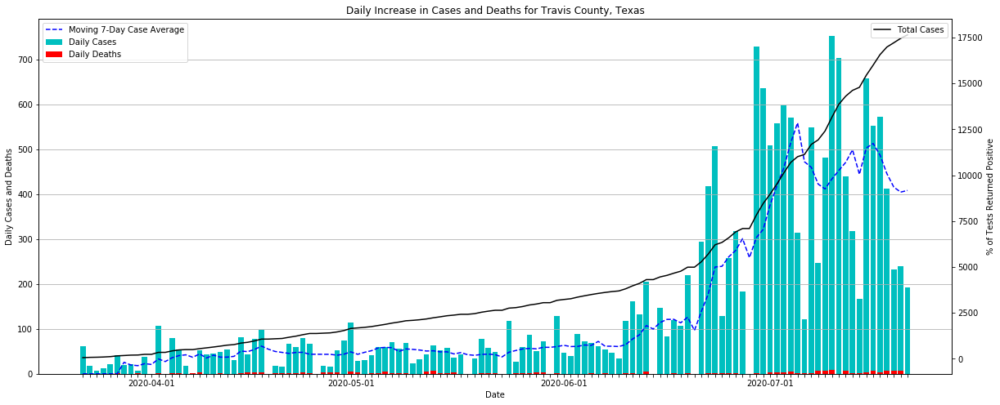

In [21]:
county_plot('48453')

In [22]:
df1.head()

,FIPS,Admin2,Province_State,Last_Update,Confirmed,Deaths,newCases,newDeaths,weekly case avg,weekly death avg,case proportion,death proportion,peak case day,County
0,36061,New York City,New York,2020-03-22,9654,63,9654,63,0.0,0.0,0.0,0.0,2020-04-18,36061 (New York)
5245,36061,New York City,New York,2020-03-23,12305,99,2651,36,0.0,0.0,0.0,0.0,2020-04-18,36061 (New York)
8422,36061,New York City,New York,2020-03-24,14904,131,2599,32,0.0,0.0,0.0,0.0,2020-04-18,36061 (New York)
11599,36061,New York City,New York,2020-03-25,17856,199,2952,68,0.0,0.0,0.0,0.0,2020-04-18,36061 (New York)
14775,36061,New York City,New York,2020-03-26,21873,281,4017,82,0.0,0.0,0.0,0.0,2020-04-18,36061 (New York)


In [23]:
def updateCounty():
    for d in df1['Last_Update'].unique():
        temp_nat = df1[df1['Last_Update']==d]
        temp_nat.fillna(0)
        fig = px_choropleth(temp_nat,
                            geojson=counties,
                            locations="FIPS",
                            scope="usa",
                            color="case proportion",
                            color_continuous_scale=px_colors.sequential.YlOrRd,
                            range_color=(0, 1),
                            title="7-Day Moving Average for "+(str(d)[:10])
                           )
        fig.update_layout(margin={"r":0,"t":50,"l":20,"b":0})
        fig.write_image("delta_county/"+(str(d)[:10])+" delta.png", scale=2)

In [24]:
# this cell updates the county information with case proportion #
# 
# 
updateCounty()

In [25]:
import statistics as stat

print("Max: "+str(max(df1['weekly case avg'])))
print("Median: "+str(stat.median(df1['weekly case avg'])))
print("Mean: "+str(stat.mean(df1['weekly case avg'])))

Max: 5323.428571428572
Median: 0.7142857142857143
Mean: 10.303835678094801


In [26]:
highestDaily = df1.sort_values(by='weekly case avg', ascending=False)
highestDaily.head(10)

,FIPS,Admin2,Province_State,Last_Update,Confirmed,Deaths,newCases,newDeaths,weekly case avg,weekly death avg,case proportion,death proportion,peak case day,County
76740,36061,New York City,New York,2020-04-18,135572,13202,8220,0,5323.428571,976.428571,1.000000,0.904938,2020-04-18,36061 (New York)
68398,36061,New York City,New York,2020-04-15,118302,8455,7837,550,5214.142857,554.857143,0.979471,0.514233,2020-04-18,36061 (New York)
71170,36061,New York City,New York,2020-04-16,123146,11477,4844,3022,5159.714286,903.857143,0.969246,0.837680,2020-04-18,36061 (New York)
60153,36061,New York City,New York,2020-04-12,103208,6898,4900,531,5093.857143,663.142857,0.956875,0.614590,2020-04-18,36061 (New York)
79542,36061,New York City,New York,2020-04-19,138700,14451,3128,1249,5070.285714,1079.000000,0.952447,1.000000,2020-04-18,36061 (New York)
54742,36061,New York City,New York,2020-04-10,92384,5820,5356,670,5032.142857,605.142857,0.945282,0.560837,2020-04-18,36061 (New York)
52084,36061,New York City,New York,2020-04-09,87028,5150,5225,579,5031.285714,536.142857,0.945121,0.496889,2020-04-18,36061 (New York)
57438,36061,New York City,New York,2020-04-11,98308,6367,5924,547,5000.285714,637.428571,0.939298,0.590759,2020-04-18,36061 (New York)
73951,36061,New York City,New York,2020-04-17,127352,13202,4206,1725,4995.428571,1054.571429,0.938386,0.977360,2020-04-18,36061 (New York)
44254,36061,New York City,New York,2020-04-06,72181,3485,4630,1229,4961.142857,385.000000,0.931945,0.356812,2020-04-18,36061 (New York)
